In [1]:
import cv2
import os 
import torch.nn as nn
import torch
from torch.utils.data import DataLoader, Dataset
import random
from PIL import Image
import torch.nn.functional as F
import matplotlib.pyplot as plt

In [2]:
class MonetDataset(Dataset):
    def __init__(self, root, transforms=None):
        self.root_path = root
        self.photo_paths = os.listdir(os.path.join(root, 'photo_jpg'))
        self.monet_paths = os.listdir(os.path.join(root, 'monet_jpg'))
        self.transform = transforms

    def __len__(self):
        return len(self.monet_paths)

    def __getitem__(self, idx):
        photoPath = os.path.join(self.root_path, 'photo_jpg', self.photo_paths[idx])
        monetPath = os.path.join(self.root_path, 'monet_jpg', self.monet_paths[idx])
        
        if self.transform:
            photo = self.transform(self.read_img(photoPath))
            monet = self.transform(self.read_img(monetPath))

        else:
            photo = self.read_img(photoPath)
            monet = self.read_img(monetPath)

        return photo, monet

    def to_tensor(self, img):
        return torch.tensor(img, dtype=torch.float32).permute(2, 0, 1)
    
    def read_img(self, path):
        return cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)

In [3]:
sample = MonetDataset('/kaggle/input/gan-getting-started')
print(len(sample))
photo, monet = sample[69]

300


In [4]:
print(photo.shape)

(256, 256, 3)


<Figure size 1000x500 with 0 Axes>

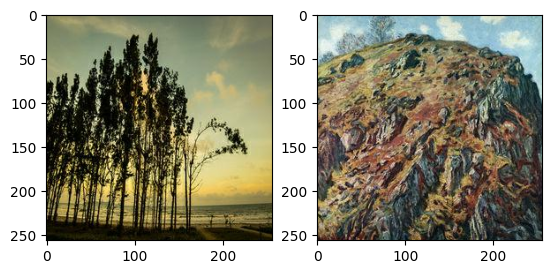

In [5]:
plt.figure(figsize=(10, 5))
fig, ax = plt.subplots(1, 2)
ax[0].imshow(photo)
ax[1].imshow(monet)
plt.show()

In [6]:
def weight_init(m):
    if any(isinstance(m, _m) for _m in [nn.Conv2d, nn.ConvTranspose2d]):
        nn.init.normal_(m.weight, mean=0.0, std=0.02)
        if m.bias is not None:
            nn.init.constant_(m.bias, 0)

U-Net

In [7]:
class DoubleConv(nn.Module):
    def __init__(self, in_channel, out_channel, isDropout=False):
        super().__init__()
        self._isDropout = isDropout
        self.conv1 = nn.Conv2d(in_channel, out_channel, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(out_channel, out_channel, kernel_size=3, padding=1)
        self.relu = nn.ReLU(inplace=True)
        self.norm = nn.InstanceNorm2d(out_channel)
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.norm(x)
        x = self.relu(x)
        
        x = self.conv2(x)
        x = self.norm(x)
        x = self.relu(x)
        
        return x

In [8]:
class DownBlock(nn.Module):
    def __init__(self, in_channel, out_channel, isDropout=False):
        super().__init__()
        self._isDropout = isDropout
        self.conv = DoubleConv(in_channel, out_channel)
        self.pooling = nn.MaxPool2d(kernel_size=2, stride=2)
    
    def forward(self, x):
        skip_out = self.conv(x)
        down_out = self.pooling(skip_out)
        
        if self._isDropout:
            down_out = F.dropout(down_out, 0.5)
            skip_out = F.dropout(skip_out, 0.5)
            
        return (down_out, skip_out)

In [9]:
class UpBlock(nn.Module):
    def __init__(self, in_channel, out_channel, isDropout=False):
        super().__init__()
        self._isDropout = isDropout
        self.conv1 = nn.ConvTranspose2d(in_channel-out_channel, in_channel-out_channel, kernel_size=2, stride=2)
        self.conv2 = DoubleConv(in_channel, out_channel)
    
    def forward(self, down_input, skip_input):
        x = self.conv1(down_input)
        x = torch.cat([x, skip_input], dim=1)
        
        x = self.conv2(x)

        if self._isDropout:
            x = F.dropout(x, 0.5)
            
        return x

In [10]:
class Generator_UNet(nn.Module):
    def __init__(self, _in_channel=3, _out_channel=3):
        super().__init__()
        
        self.network = []
        
        #Down
        self.downBlock1 = DownBlock(in_channel=_in_channel, out_channel=64)
        self.downBlock2 = DownBlock(in_channel=64, out_channel=128)
        self.downBlock3 = DownBlock(in_channel=128, out_channel=256)
        self.downBlock4 = DownBlock(in_channel=256, out_channel=512)
        
        #BottleNeck
        self.bottleneck = DoubleConv(512, 1024)
        
        #Up
        self.upBlock1 = UpBlock(in_channel=1024+512, out_channel=512, isDropout=True)
        self.upBlock2 = UpBlock(in_channel=512+256, out_channel=256, isDropout=True)
        self.upBlock3 = UpBlock(in_channel=256+128, out_channel=128, isDropout=True)
        self.upBlock4 = UpBlock(in_channel=128+64, out_channel=64)
                
        #Final
        self.finalConv = nn.Conv2d(64, _out_channel, kernel_size=1)
                
    def forward(self, x):
        x, skip_out_1 = self.downBlock1(x)
        x, skip_out_2 = self.downBlock2(x)
        x, skip_out_3 = self.downBlock3(x)
        x, skip_out_4 = self.downBlock4(x)
        
        x = self.bottleneck(x)
        
        x = self.upBlock1(x, skip_out_4)
        x = self.upBlock2(x, skip_out_3)
        x = self.upBlock3(x, skip_out_2)
        x = self.upBlock4(x, skip_out_1)
        
        out = self.finalConv(x)
        return out

In [11]:
gen = Generator_UNet()

In [12]:
print(photo.shape)
test = gen(sample.to_tensor(photo).unsqueeze(0))
print(test.shape)

(256, 256, 3)
torch.Size([1, 3, 256, 256])


<Figure size 1000x500 with 0 Axes>

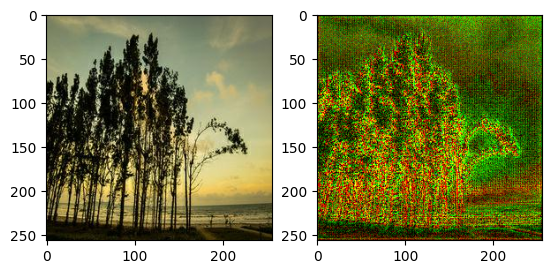

In [13]:
plt.figure(figsize=(10, 5))
fig, ax = plt.subplots(1, 2)
ax[0].imshow(photo)
ax[1].imshow(test.detach().numpy().squeeze().transpose(1, 2, 0))
plt.show()

In [14]:
def unnormalize(img, mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]):
    for t, m, s in zip(img, mean, std):
        t.mul_(s).add_(s)
        
    return img

In [15]:
class DownSample_Dis(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, isNorm=True):
        super().__init__()
        self._isNorm = isNorm
        
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding=kernel_size//2)
        self.norm = nn.InstanceNorm2d(out_channels)
        self.relu = nn.LeakyReLU(negative_slope=0.2)
        self.apply(weight_init)
        
    def forward(self, x):
        out = self.conv(x)
        if self._isNorm:
            out = self.norm(out)
        out = self.relu(out)
        return out

In [16]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()

        self.network = []
        self.network.append(DownSample_Dis(in_channels=3, out_channels=64, kernel_size=4, stride=2, isNorm=False))
        self.network.append(DownSample_Dis(in_channels=64, out_channels=128, kernel_size=4, stride=2))
        self.network.append(DownSample_Dis(in_channels=128, out_channels=256, kernel_size=4, stride=2))
        self.network.append(DownSample_Dis(in_channels=256, out_channels=512, kernel_size=4, stride=2))
        self.network.append(nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4, stride=1))
        
        self.model = nn.Sequential(*self.network)
        self.apply(weight_init)

    def forward(self, x):
        x = self.model(x)
        x = nn.Dropout(0.5)(x)
        return F.avg_pool2d(x, x.size()[2:]).view(x.size()[0], -1)

In [17]:
class MultiScaleDiscriminator(nn.Module):
    def __init__(self, num_scales=3):
        super(MultiScaleDiscriminator, self).__init__()
        self.discriminators = nn.ModuleList([Discriminator() for _ in range(num_scales)])
        self.downsample = nn.AvgPool2d(3, stride=2, padding=[1, 1], count_include_pad=False)

    def forward(self, x):
        results = []
        for D in self.discriminators:
            results.append(D(x))
            x = self.downsample(x)
        return results

In [18]:
dis = Discriminator()


In [19]:
t = dis(test)
print(t)

tensor([[0.7556]], grad_fn=<ViewBackward0>)


In [20]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
lambda_cycle = 10
lambda_identity = 0.5 * lambda_cycle
lambda_perceptual = 0.5 * lambda_cycle
num_epochs = 20
decay_epochs = 20
buffer_size = 50
learning_rate = 2e-4
# Model
gen_type = "UNet"
using_data_aug = True
using_identity_loss = False
using_perceptual_loss = True
using_multiscale_discriminator = True

In [21]:
gen_AB = Generator_UNet()
gen_AB.apply(weight_init)
gen_BA = Generator_UNet()
gen_BA.apply(weight_init)

dis_A = MultiScaleDiscriminator()
dis_B = MultiScaleDiscriminator()

gen_AB.to(device)
gen_BA.to(device)
dis_A.to(device)
dis_B.to(device)

MultiScaleDiscriminator(
  (discriminators): ModuleList(
    (0-2): 3 x Discriminator(
      (model): Sequential(
        (0): DownSample_Dis(
          (conv): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(2, 2))
          (norm): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          (relu): LeakyReLU(negative_slope=0.2)
        )
        (1): DownSample_Dis(
          (conv): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(2, 2))
          (norm): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          (relu): LeakyReLU(negative_slope=0.2)
        )
        (2): DownSample_Dis(
          (conv): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(2, 2))
          (norm): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=False, track_running_stats=False)
          (relu): LeakyReLU(negative_slope=0.2)
        )
        (3): DownSample_Dis(
          (conv): Conv2d(256, 5

In [22]:
import torch
import torch.nn as nn
import torchvision.models as models

vgg = models.vgg19(pretrained=True).features.cuda().eval()

for param in vgg.parameters():
    param.requires_grad = False

criterion_perceptual = nn.MSELoss()

def perceptual_loss(fake_img, real_img):
    fake_features = vgg(fake_img)
    real_features = vgg(real_img)
    return criterion_perceptual(fake_features, real_features)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:03<00:00, 182MB/s] 


In [23]:
# loss function
criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()
criterion_identity = nn.L1Loss()

In [24]:
from torchvision import transforms

transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

transform_Augmentation = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((286, 286), Image.BICUBIC),
    transforms.RandomCrop((256, 256)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

In [25]:
# Dataloader
from torch.utils.data import DataLoader

if using_data_aug:
    monetDataset = MonetDataset('/kaggle/input/gan-getting-started', transform_Augmentation)
else:
    monetDataset = MonetDataset('/kaggle/input/gan-getting-started', transform)

#train_set, vaild_set = torch.utils.data.random_split(monetDataset, [len(monetDataset) - 50, 50])
#train_dataloader = DataLoader(dataset=train_set, batch_size=8, shuffle=True)
#vaild_dataloader = DataLoader(dataset=vaild_set, batch_size=1, shuffle=True)
dataloader = DataLoader(dataset=monetDataset, batch_size=1, shuffle=True, pin_memory=True)

In [26]:
from torch.optim import lr_scheduler
import itertools

# Optimizer & LR scheduler
optimizer_G = torch.optim.Adam(itertools.chain(gen_AB.parameters(), gen_BA.parameters()), lr=learning_rate, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(itertools.chain(dis_A.parameters(), dis_B.parameters()), lr=learning_rate, betas=(0.5, 0.999))

LambdaLR = lambda epoch: 1 - max(0, epoch - decay_epochs + 1) / (num_epochs - decay_epochs + 1)
scheduler_G = lr_scheduler.LambdaLR(optimizer_G, lr_lambda=LambdaLR)
scheduler_D = lr_scheduler.LambdaLR(optimizer_D, lr_lambda=LambdaLR)

In [27]:
class ImageBuffer():
    def __init__(self):
        self.buffer = []
        self.max_size = 50
    
    def push_and_pop(self, datas):
        return_imgs = []
        for element in datas.data:
            element = torch.unsqueeze(element, 0)
            if len(self.buffer) < self.max_size:
                self.buffer.append(element)
                return_imgs.append(element)
            else:
                if random.uniform(0, 1) > 0.5:
                    i = random.randint(0, self.max_size - 1)
                    return_imgs.append(self.buffer[i].clone())
                    self.buffer[i] = element
                else:
                    return_imgs.append(element)
                    
        return torch.cat(return_imgs, 0)

In [28]:
def plot_image(amount):
    _, ax = plt.subplots(amount, 2, figsize=(12, 12))

    if amount == 1:
        ax = [ax]
    
    for i in range(amount):
        photo, _ = monetDataset[i]
        photo = photo.unsqueeze(0)

        with torch.no_grad():
            monet = gen_AB(photo.to(device)).cpu().detach()

        photo = unnormalize(photo)
        monet = unnormalize(monet)

        ax[i][0].imshow(photo.squeeze().permute(1, 2, 0))
        ax[i][1].imshow(monet.squeeze().permute(1, 2, 0))
        ax[i][0].axis("off")
        ax[i][1].axis("off")
      
    plt.show()

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 1 | Generator Loss: 6.501616036097209 | Discriminator Loss: 5.3861207426587745


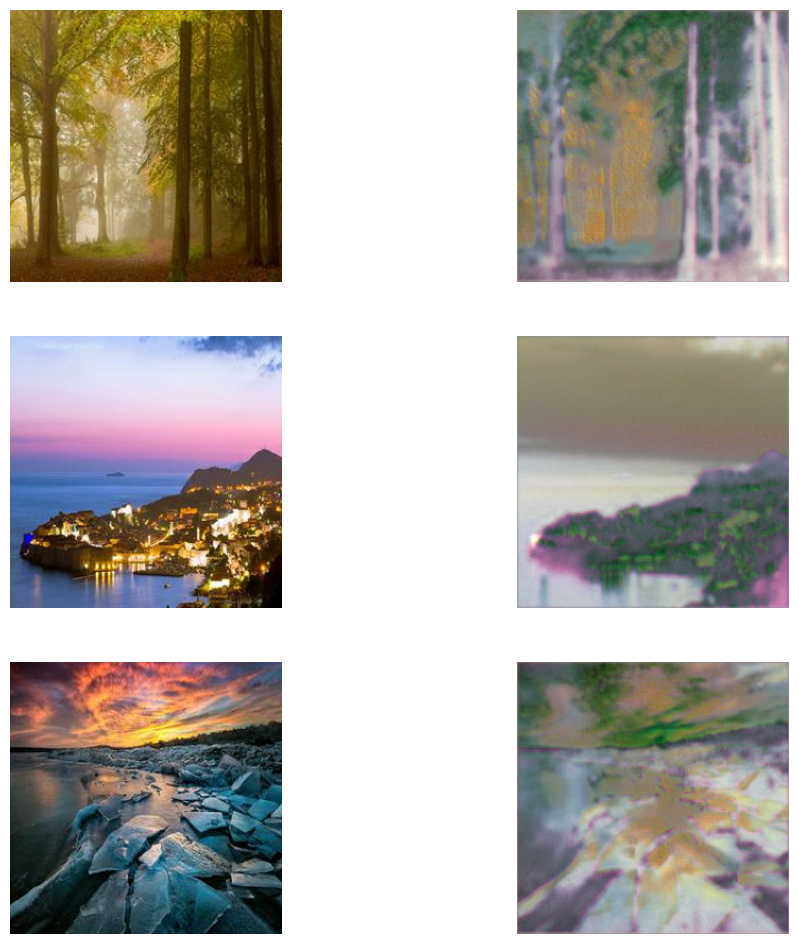

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 2 | Generator Loss: 4.088260950247447 | Discriminator Loss: 1.7810784315069517


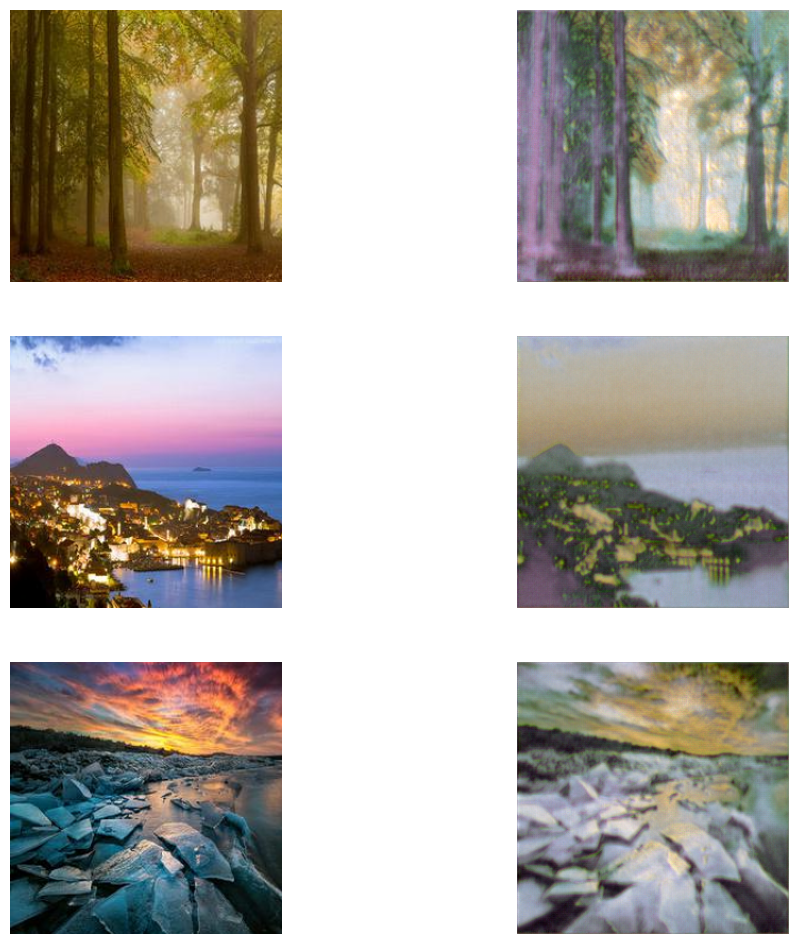

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 3 | Generator Loss: 3.653979804118474 | Discriminator Loss: 1.5162263981004556


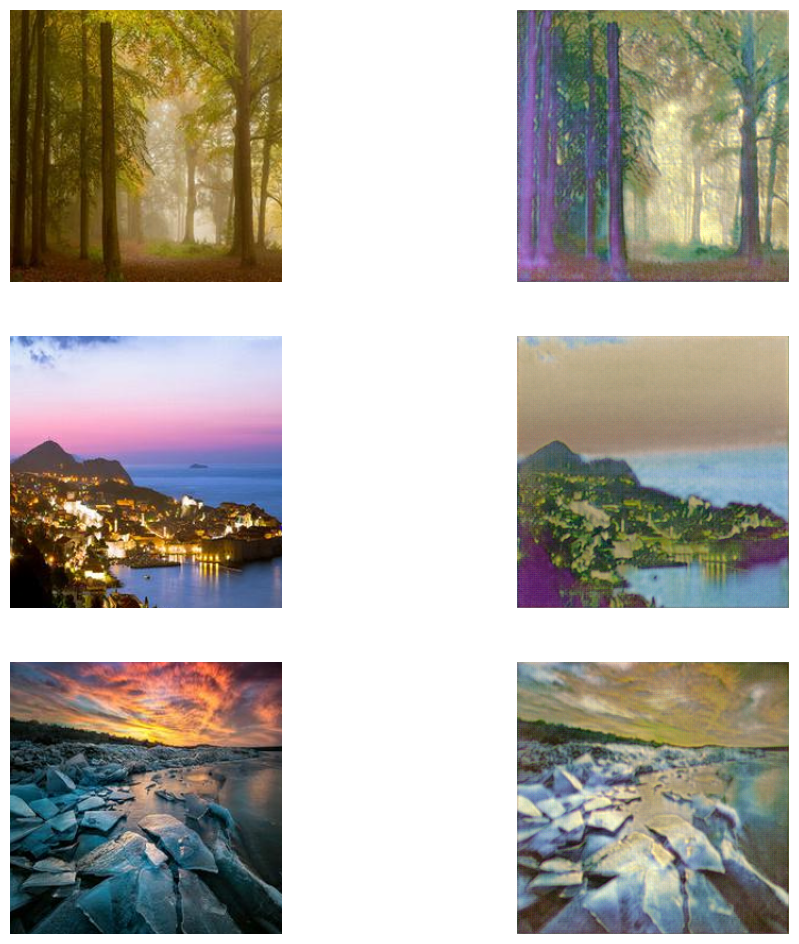

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 4 | Generator Loss: 3.4867335669199626 | Discriminator Loss: 1.5759393106897672


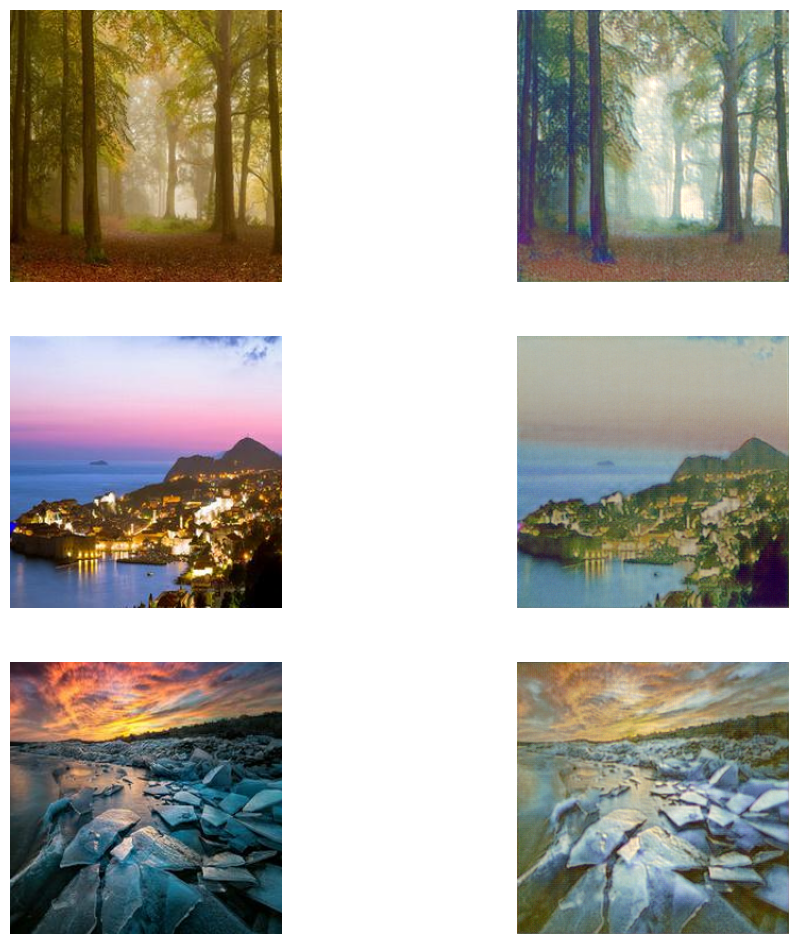

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 5 | Generator Loss: 3.3400190651416777 | Discriminator Loss: 1.3840753801663717


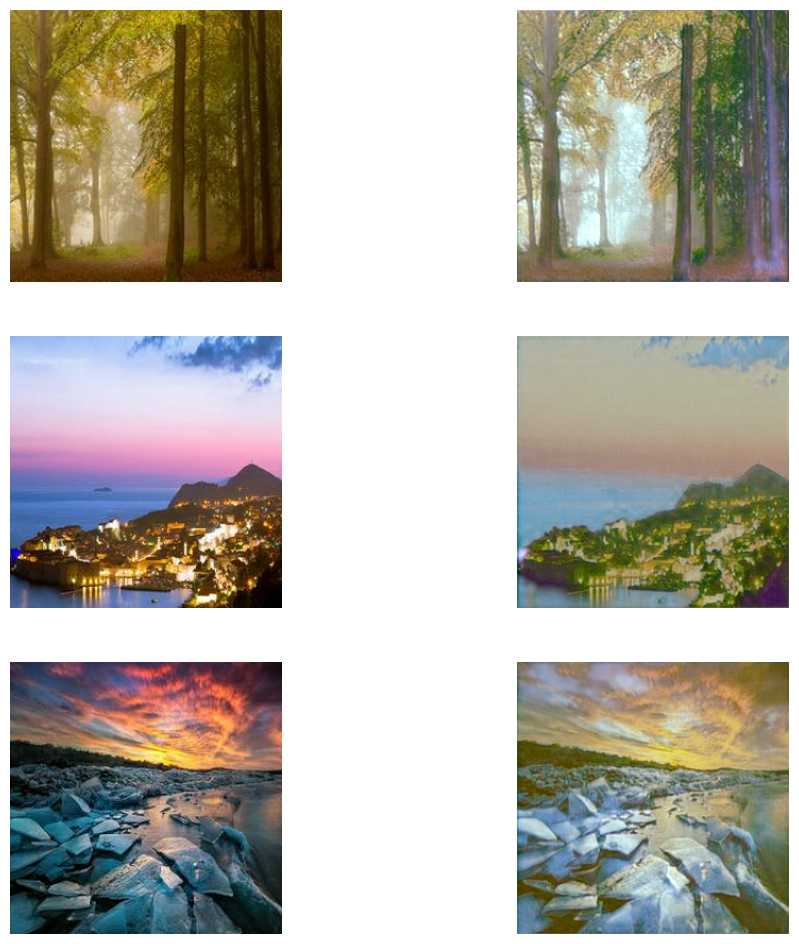

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 6 | Generator Loss: 3.3305997812747954 | Discriminator Loss: 1.3013038888573647


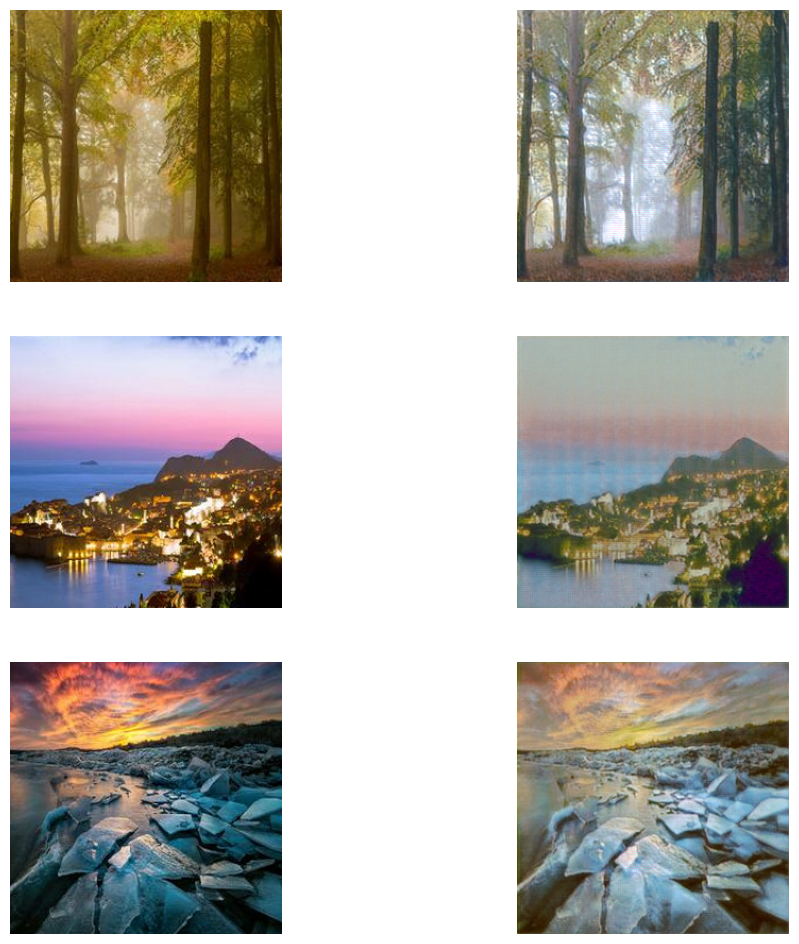

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 7 | Generator Loss: 3.3263554763793945 | Discriminator Loss: 1.3614415191113949


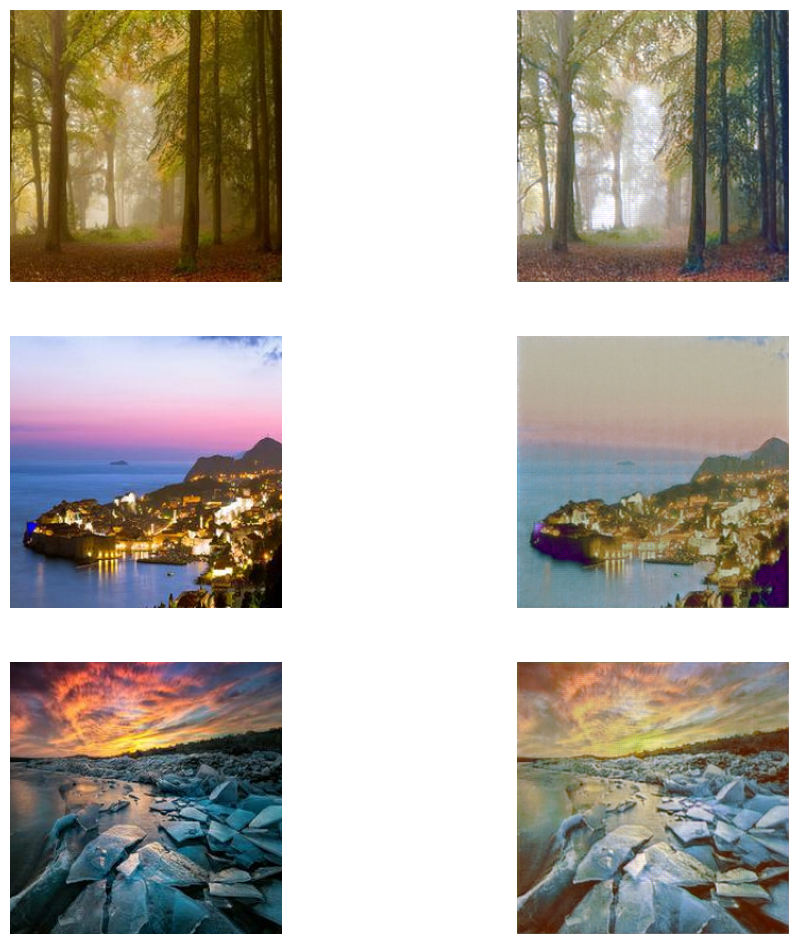

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 8 | Generator Loss: 3.239132883946101 | Discriminator Loss: 1.1440095739563305


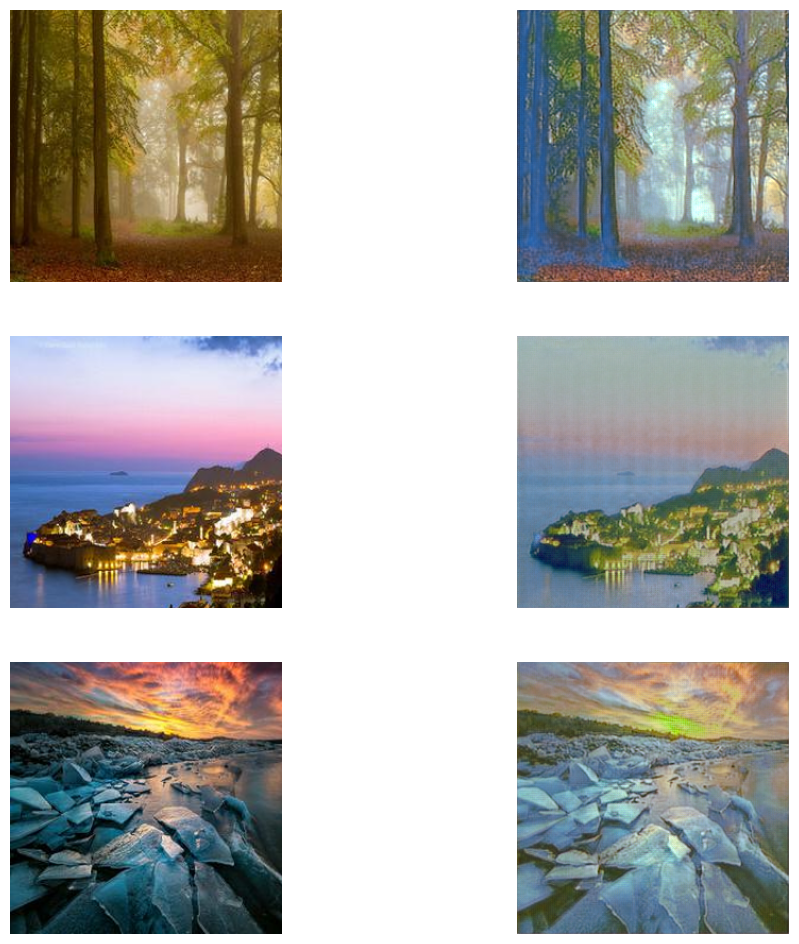

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 9 | Generator Loss: 3.132493262688319 | Discriminator Loss: 1.357946041971445


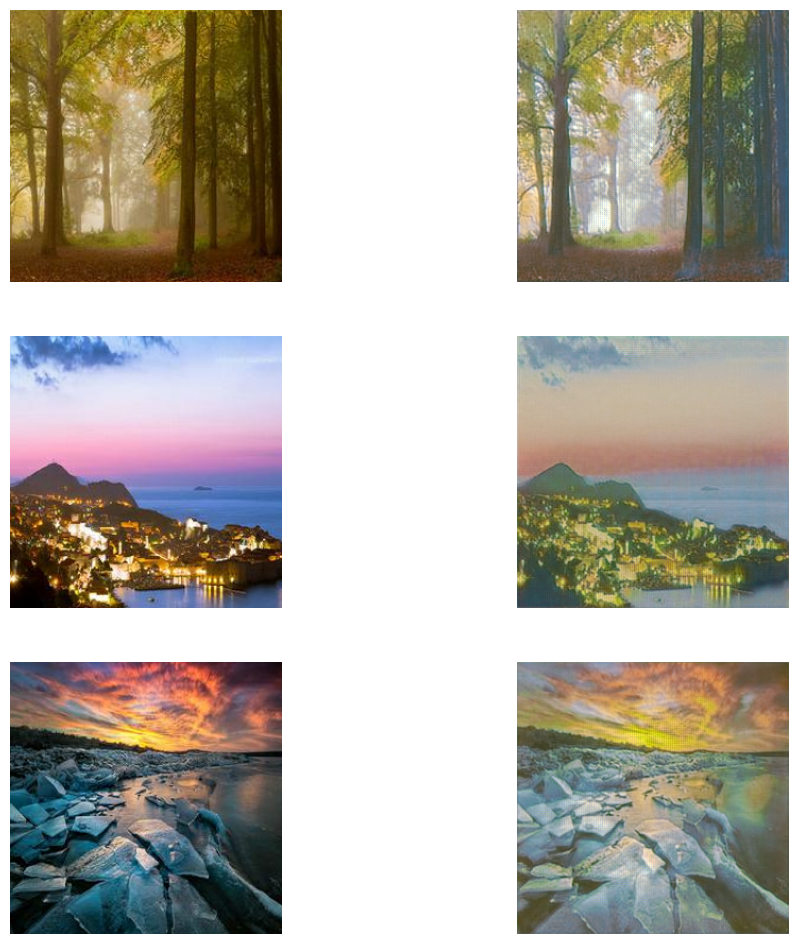

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 10 | Generator Loss: 3.116677098274231 | Discriminator Loss: 1.4156980913877488


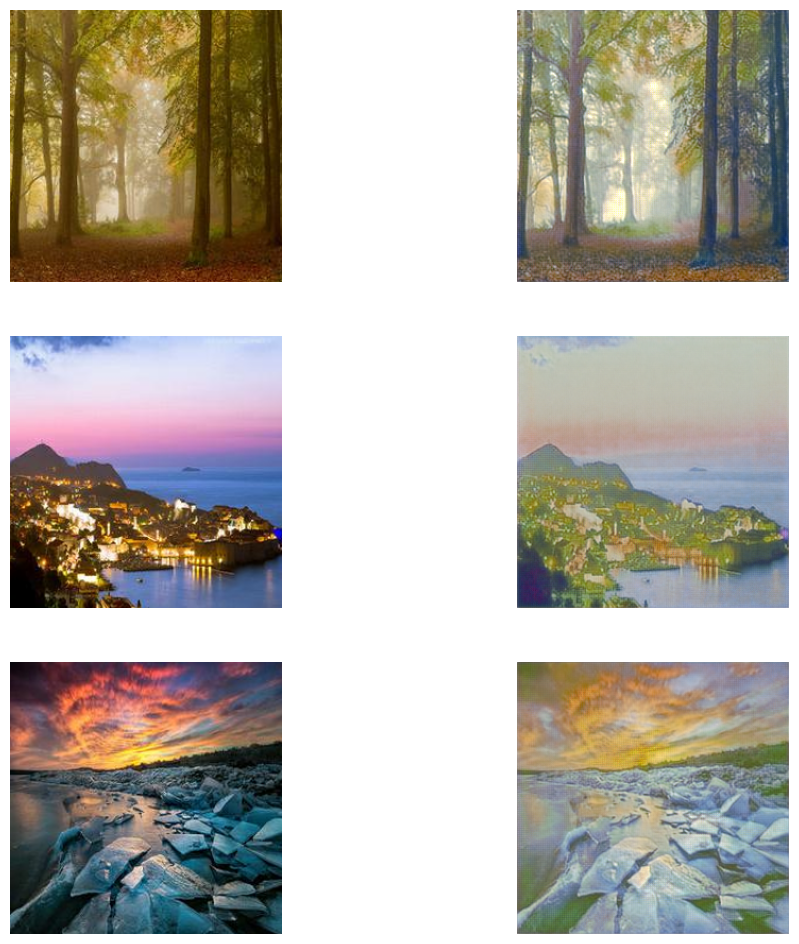

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 11 | Generator Loss: 2.9453379770119983 | Discriminator Loss: 1.1781776019930839


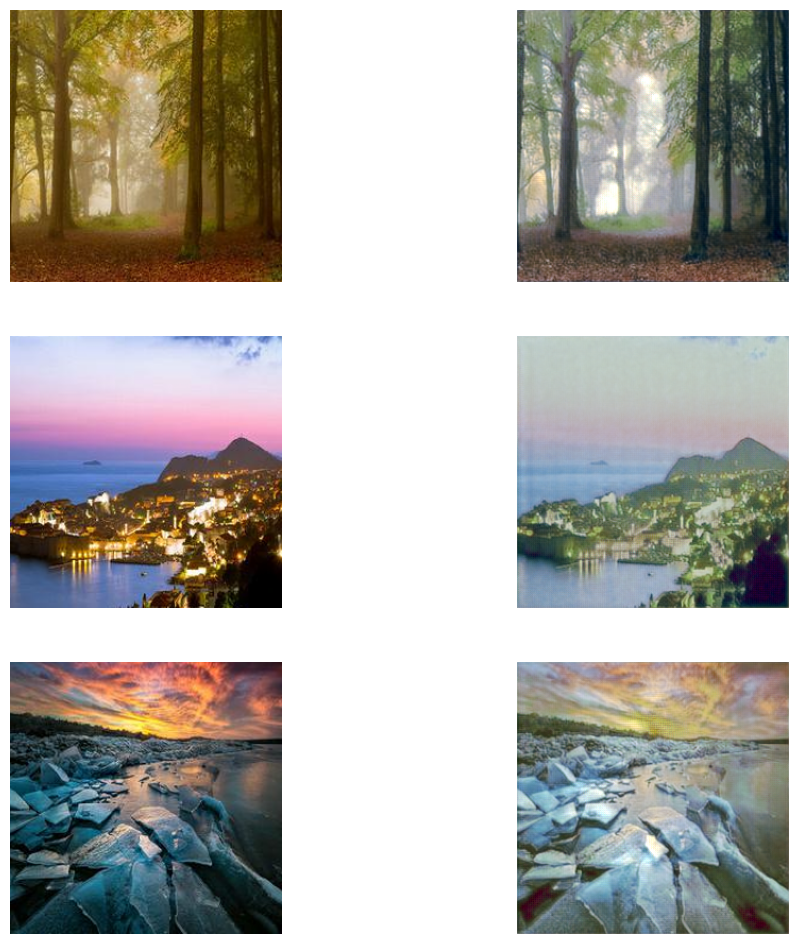

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 12 | Generator Loss: 2.9621949211756387 | Discriminator Loss: 1.1737904892365139


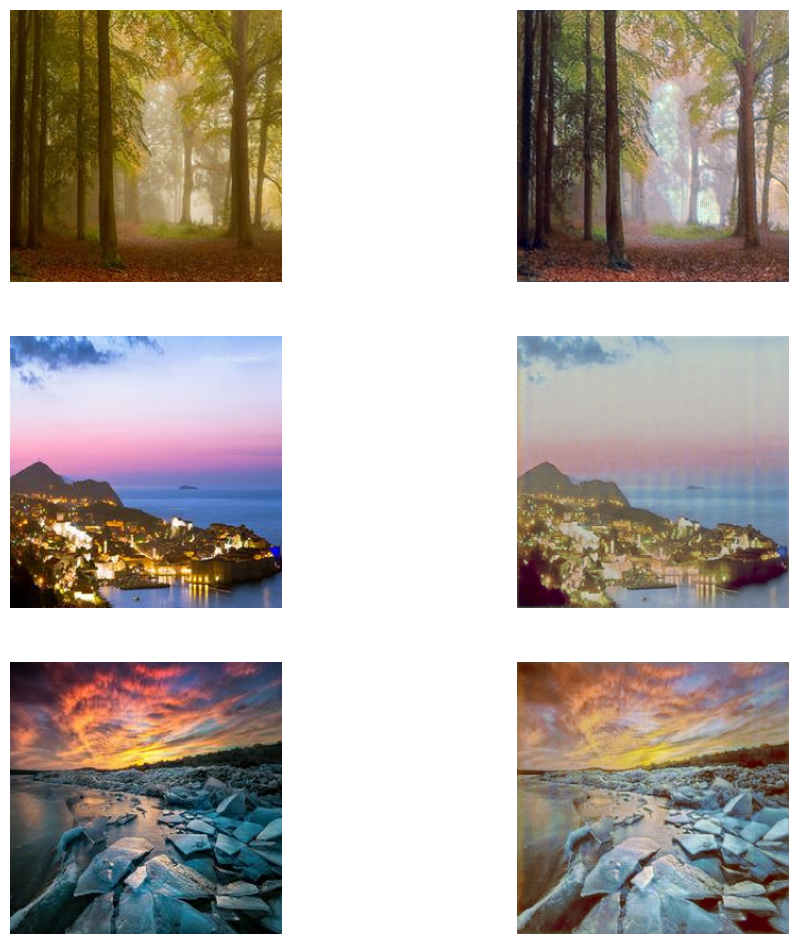

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 13 | Generator Loss: 2.898683785200119 | Discriminator Loss: 1.0965572087963422


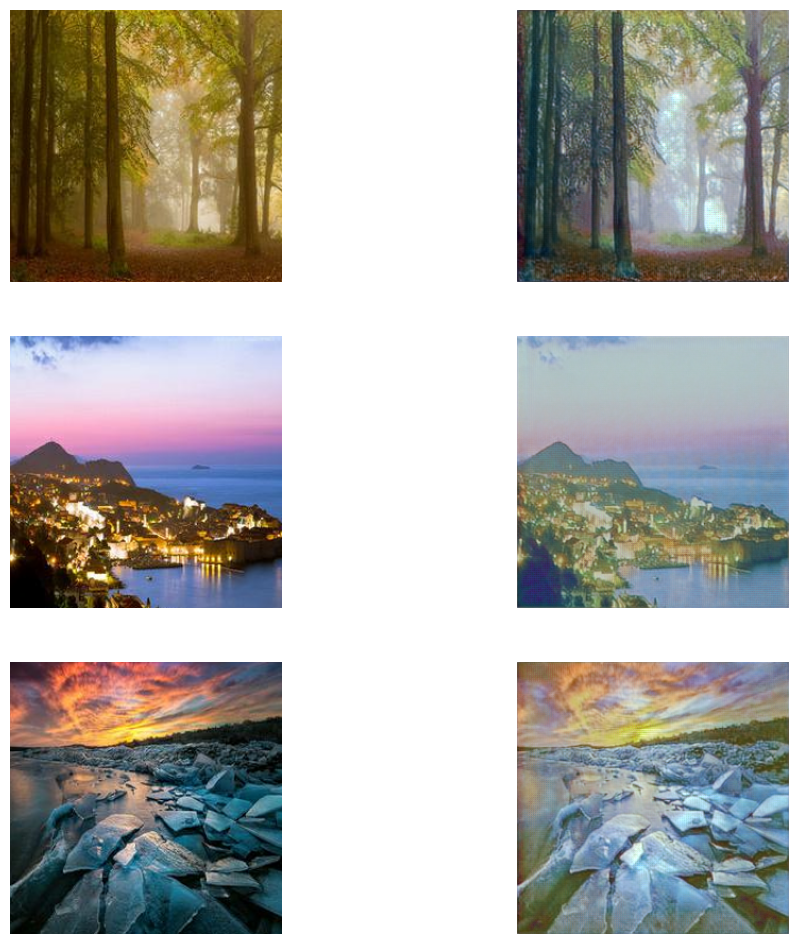

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 14 | Generator Loss: 2.850938105980555 | Discriminator Loss: 1.1981647608677546


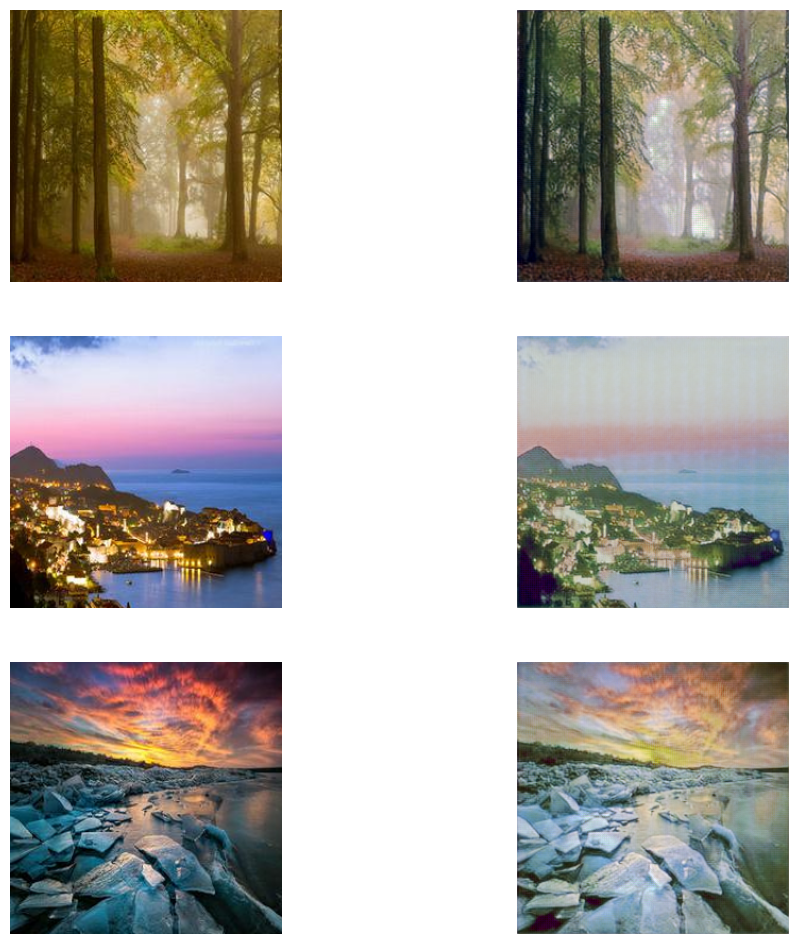

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 15 | Generator Loss: 2.787575763861338 | Discriminator Loss: 1.2255869945635398


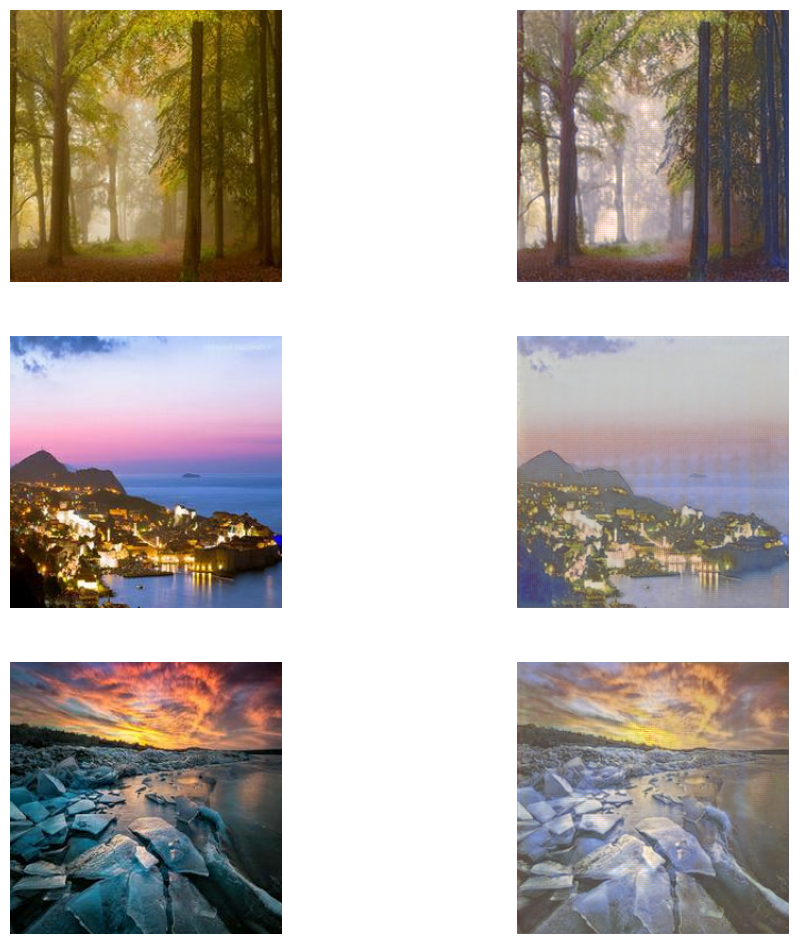

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 16 | Generator Loss: 2.7714187026023867 | Discriminator Loss: 1.492183709591627


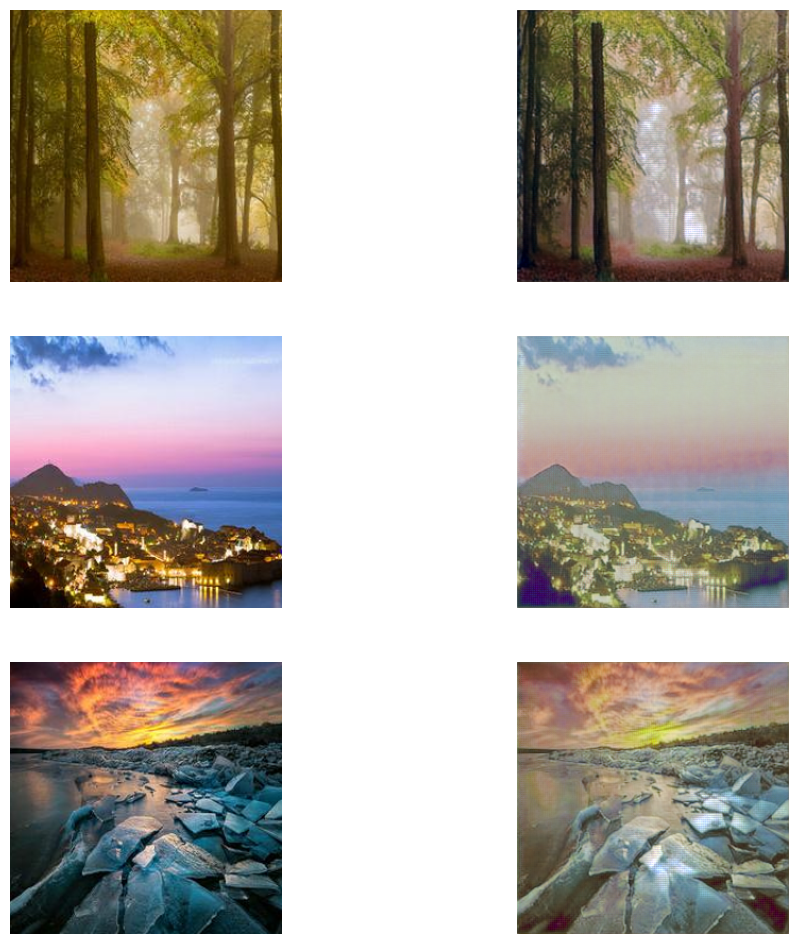

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 17 | Generator Loss: 2.7292139971256257 | Discriminator Loss: 1.4398396451274553


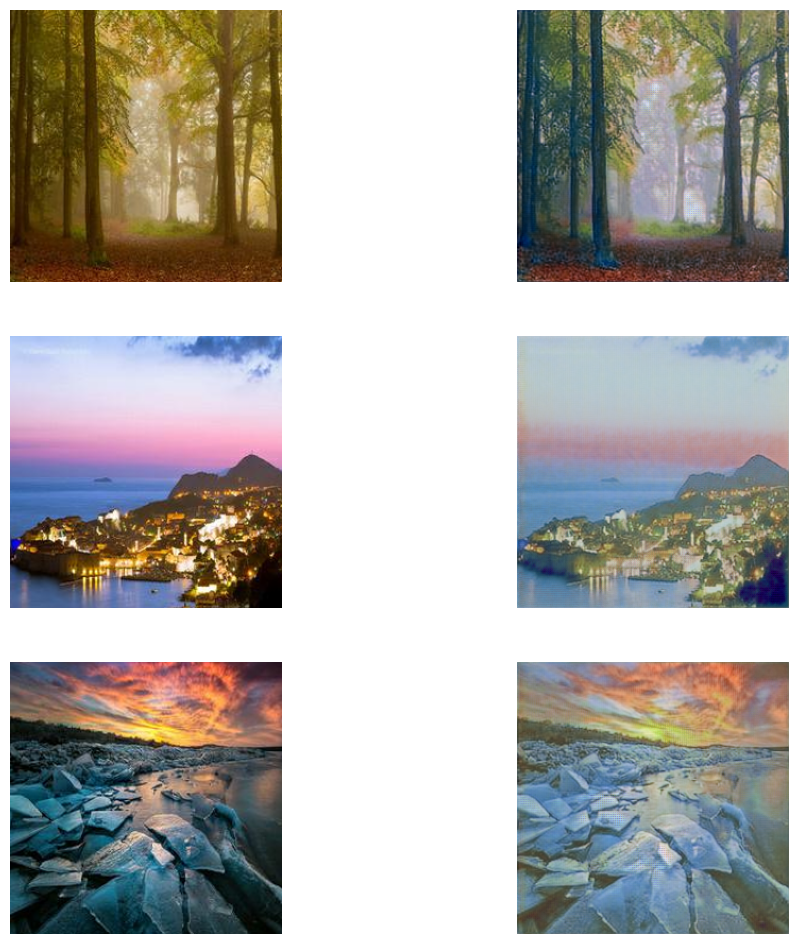

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 18 | Generator Loss: 2.6682522642612456 | Discriminator Loss: 1.2144116135934988


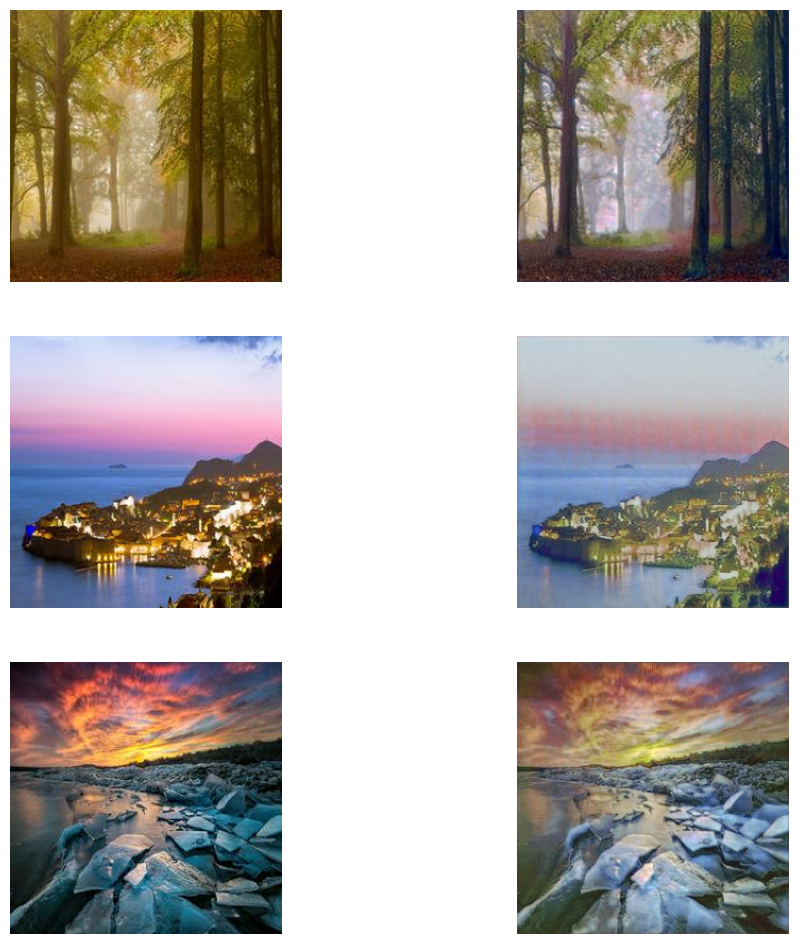

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 19 | Generator Loss: 2.6414489777882895 | Discriminator Loss: 1.239008867740631


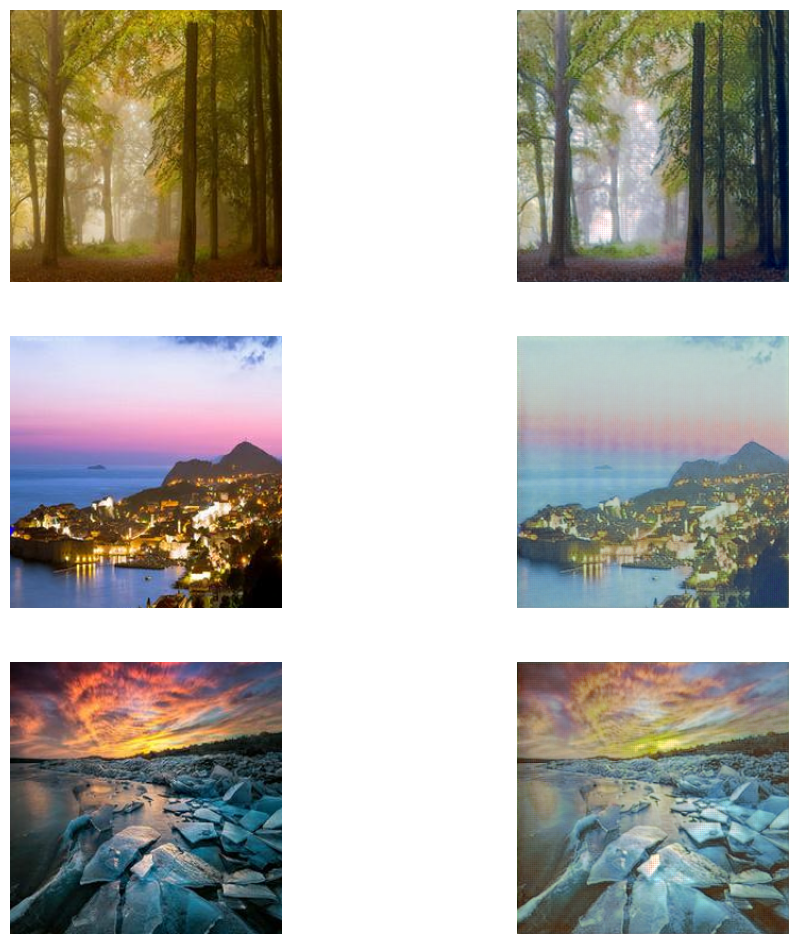

  0%|          | 0/300 [00:00<?, ?it/s]

Epoch: 20 | Generator Loss: 2.5715835285186768 | Discriminator Loss: 1.1558223826686542


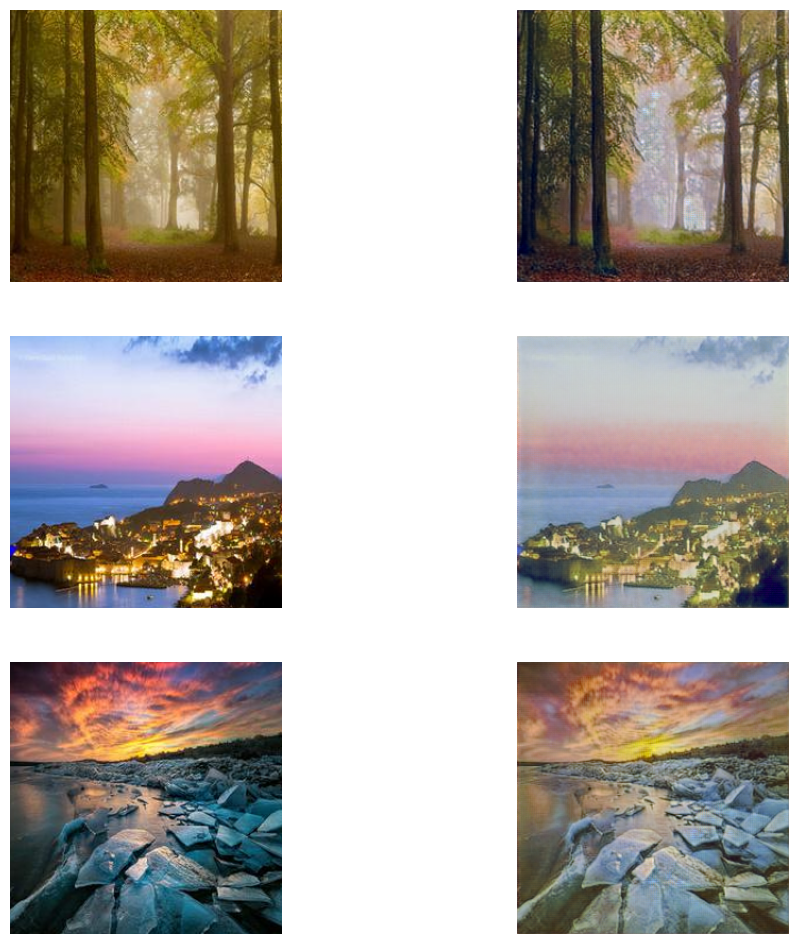

In [29]:
from collections import defaultdict
from tqdm.auto import tqdm
logger = list()

for epoch in range(1, num_epochs+1):
    loss_batch = defaultdict(float)
    x_fake_A_buffer = ImageBuffer()
    x_fake_B_buffer = ImageBuffer()
    
    total_g_loss = 0.0
    total_d_loss = 0.0
    
    for i, data in enumerate(tqdm(dataloader)):
        # Data
        x_A = data[0].to(device) #photo
        x_B = data[1].to(device) #monet

        # Generators
        gen_AB.zero_grad()
        gen_BA.zero_grad()

        # Generate
        x_fake_A = gen_BA(x_B)
        x_fake_B = gen_AB(x_A)

        # Adversarial
        x_adv_A = dis_A(x_fake_A)
        x_adv_B = dis_B(x_fake_B)

        # Cycle
        x_cycle_A = gen_BA(x_fake_B)
        x_cycle_B = gen_AB(x_fake_A)


        g_loss_adv_A = 0
        g_loss_adv_B = 0
        if using_multiscale_discriminator:
            for adv_A, adv_B in zip(x_adv_A, x_adv_B):
                g_loss_adv_A += criterion_GAN(adv_A, torch.ones_like(adv_A))
                g_loss_adv_B += criterion_GAN(adv_B, torch.ones_like(adv_B))

            g_loss_adv_A /= len(x_adv_A)
            g_loss_adv_B /= len(x_adv_B)
        else:
            g_loss_adv_A = criterion_GAN(x_adv_A, torch.ones_like(x_adv_A))
            g_loss_adv_B = criterion_GAN(x_adv_B, torch.ones_like(x_adv_B))


        # Cycle loss
        g_loss_cycle_A = criterion_cycle(x_cycle_A, x_A) * lambda_cycle 
        g_loss_cycle_B = criterion_cycle(x_cycle_B, x_B) * lambda_cycle

        # Identity loss
        g_loss_identity_A = criterion_identity(x_cycle_A, x_A) * lambda_identity if using_identity_loss else 0
        g_loss_identity_B = criterion_identity(x_cycle_B, x_B) * lambda_identity if using_identity_loss else 0

        # Perceptual loss
        g_loss_perceptual_A = criterion_perceptual(x_cycle_A, x_A) * lambda_perceptual if using_perceptual_loss else 0
        g_loss_perceptual_B = criterion_perceptual(x_cycle_B, x_B) * lambda_perceptual if using_perceptual_loss else 0

        g_loss_A = g_loss_adv_A + g_loss_cycle_A + g_loss_identity_A + g_loss_perceptual_A
        g_loss_B = g_loss_adv_B + g_loss_cycle_B + g_loss_identity_B + g_loss_perceptual_B
        g_loss = (g_loss_A + g_loss_B) / 2 
              
        g_loss.backward()
        total_g_loss += g_loss.item()

        optimizer_G.step()

        # Discriminators
        dis_A.zero_grad()
        dis_B.zero_grad()

        # photo
        x_fake_A = x_fake_A_buffer.push_and_pop(x_fake_A)
        d_real_A = dis_A(x_A)
        d_fake_A = dis_A(x_fake_A.detach())
        
        # monet
        x_fake_B = x_fake_B_buffer.push_and_pop(x_fake_B)
        d_real_B = dis_B(x_B)
        d_fake_B = dis_B(x_fake_B.detach())
        
        d_loss_A = 0 
        d_loss_B = 0
        # Discriminator Loss
        if using_multiscale_discriminator:
            for real_A, fake_A, real_B, fake_B in zip(d_real_A, d_fake_A, d_real_B, d_fake_B):
                d_loss_A += criterion_GAN(real_A, torch.ones_like(real_A)) + criterion_GAN(fake_A, torch.zeros_like(fake_A))
                d_loss_B += criterion_GAN(real_B, torch.ones_like(real_B)) + criterion_GAN(fake_B, torch.zeros_like(fake_B))
                
            d_loss_A /= len(d_real_A)
            d_loss_A /= len(d_real_B)
        else:
            d_loss_A = criterion_GAN(d_real_A, torch.ones_like(d_real_A)) + criterion_GAN(d_fake_A, torch.zeros_like(d_fake_A))
            d_loss_B = criterion_GAN(d_real_B, torch.ones_like(d_real_B)) + criterion_GAN(d_fake_B, torch.zeros_like(d_fake_B))

        d_loss = (d_loss_A + d_loss_B) / 2

        d_loss.backward()
        total_d_loss += d_loss.item()
        optimizer_D.step()
    
    avg_g_loss = total_g_loss / len(dataloader)
    avg_d_loss = total_d_loss / len(dataloader)
    
    logger.append({
        'g_loss': avg_g_loss,
        'd_loss': avg_d_loss
    })

    scheduler_G.step()
    scheduler_D.step()
    
    print(f"Epoch: {epoch} | Generator Loss: {avg_g_loss} | Discriminator Loss: {avg_d_loss}")
    plot_image(3)
    #torch.save(gen_AB.state_dict(), f'gen_AB_{epoch}.pth')
        

In [30]:
g_loss = []
d_loss = []

for log in logger:
    g_loss.append(log['g_loss'])
    d_loss.append(log['d_loss'])

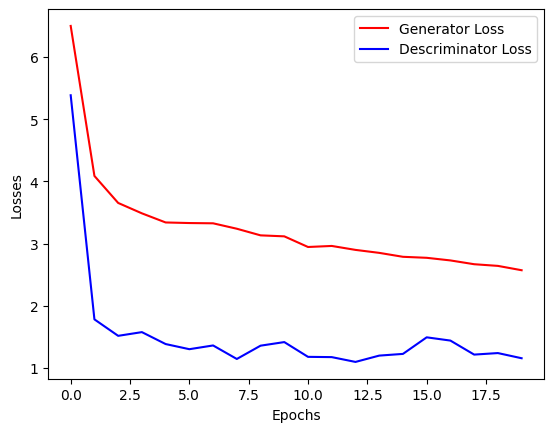

In [31]:
plt.xlabel("Epochs")
plt.ylabel("Losses")
plt.plot(g_loss, 'r', label='Generator Loss')
plt.plot(d_loss, 'b', label='Descriminator Loss')
plt.legend()
plt.show()

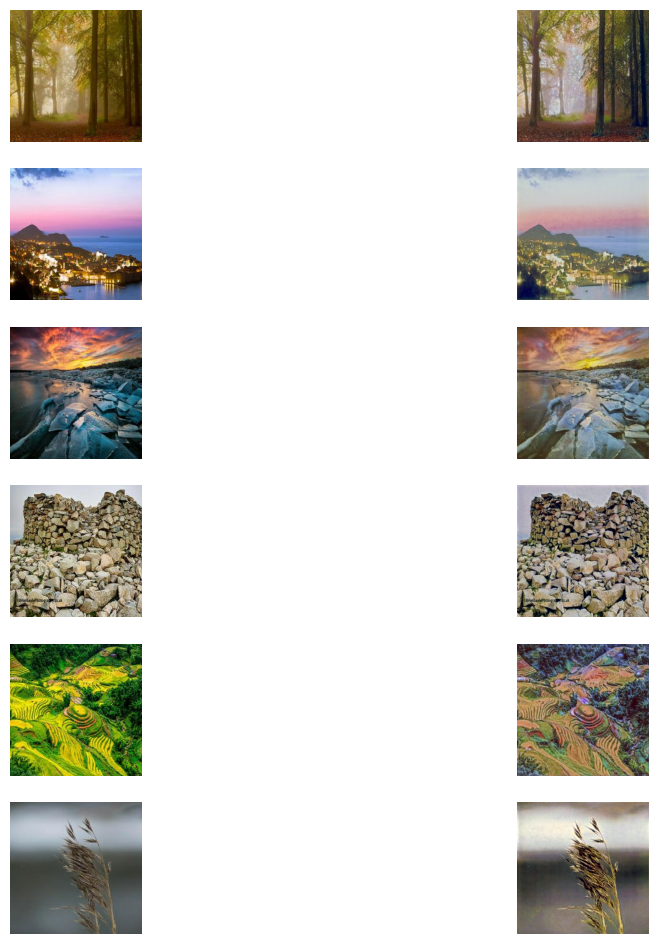

In [32]:
gen_AB.eval()
plot_image(6)

OutPut

In [33]:
class PhotoDataset(Dataset):
    def __init__(self, root, transforms=None):
        self.root_path = root
        self.photo_paths = os.listdir(os.path.join(root, 'photo_jpg'))
        self.transform = transforms

    def __len__(self):
        return len(self.photo_paths)

    def __getitem__(self, idx):
        photoPath = os.path.join(self.root_path, 'photo_jpg', self.photo_paths[idx])

        if self.transform:
            photo = self.transform(self.read_img(photoPath))

        else:
            photo = self.read_img(photoPath)

        return photo

    def to_tensor(self, img):
        return torch.tensor(img, dtype=torch.float32).permute(2, 0, 1)
    
    def read_img(self, path):
        return cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)

In [34]:
fin_ds = PhotoDataset('../input/gan-getting-started', transforms=transform)
fin_dl = DataLoader(fin_ds, batch_size=1)

In [35]:
os.makedirs('../images', exist_ok=True)

In [36]:
t = transforms.ToPILImage()

In [37]:
gen_AB.eval()

for i, photo in enumerate(tqdm(fin_dl)):
    photo = photo.to(device) #photo
    with torch.no_grad():
        pred_monet = gen_AB(photo).cpu().detach()
    pred_monet = unnormalize(pred_monet)
    img = t(pred_monet.squeeze())
    img.save(f'../images/{i+1}.jpg')

  0%|          | 0/7038 [00:00<?, ?it/s]

In [38]:
import shutil
shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

'/kaggle/working/images.zip'